# Imports and Definitions

In [1]:
!pip install einops

In [2]:
# # Для работы в колабе раскоменьте эти строки
# !git clone https://github.com/HSE-LAMBDA/DeepGenerativeModels.git
# %cd DeepGenerativeModels/

In [3]:
# from google.colab import drive
# drive.mount('/content/gdrive')

In [4]:
import einops

import random
import imageio
import numpy as np
from argparse import ArgumentParser


from tqdm.auto import tqdm
import matplotlib.pyplot as plt

import torch
import torch.nn as nn
from torch.optim import Adam
from torch.utils.data import DataLoader

from torchvision.transforms import Compose, ToTensor, Lambda, Resize
from torchvision.datasets.mnist import MNIST, FashionMNIST
# from torchvision.datasets import CelebA # Можете использовать стандартный даталодер, если квота гдрайва позволяет
# from utils.datasets.celeba import CelebADataset as CelebA


SEED = 0
random.seed(SEED)
np.random.seed(SEED)
torch.manual_seed(SEED)

/Users/arabor/Desktop/1/.venv/lib/python3.9/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


# Визуализация данных

In [5]:
def show_images(images, title=""):
    """Shows the provided images as sub-pictures in a square"""

    # Converting images to CPU numpy arrays
    if type(images) is torch.Tensor:
        images = images.detach().cpu().permute(0,2,3,1).numpy()

    # Defining number of rows and columns
    fig = plt.figure(figsize=(8, 8))
    rows = int(len(images) ** (1 / 2))
    cols = round(len(images) / rows)

    # Populating figure with sub-plots
    idx = 0
    for r in range(rows):
        for c in range(cols):
            fig.add_subplot(rows, cols, idx + 1)

            if idx < len(images):
                plt.imshow((255*(images[idx]+1)/2).astype('uint8'))
                idx += 1
    fig.suptitle(title, fontsize=30)

    # Showing the figure
    plt.show()

In [6]:
def show_first_batch(loader):
    for batch in loader:
        show_images(batch[0], "Первый батч")
        break

## Загрузка данных (0 баллов)

Мы будем использовать CelebA (32x32). **Важно**: отнормируйте данные в интервал `[-1,1]`.

In [7]:
# !cd /content/gdrive/MyDrive/celeba && unzip img_align_celeba.zip > /dev/null # распаковка

In [8]:
#!g1.1
import torch
import torch.nn as nn
import torch.nn.functional as F
from torchvision import transforms
import matplotlib.pyplot as plt
import numpy as np
import math
from tqdm.auto import trange, tqdm
import os 
from torch import nn

from torch import Tensor
t_normalize = lambda x: (x * x * 2 - 1) * x
t_invnormalize = lambda x: math.sqrt((x + 1) / 2)
transform=transforms.Compose([
    transforms.Resize(64),
    transforms.CenterCrop(64),
    transforms.ToTensor(),
    t_normalize,
])

#!g1.1
from random import randint
from celeba_1 import CelebADataset as CelebADataset1

batch_size = 128
image_size = 32

class CelebaCustomDataset(CelebADataset1):
    def __getitem__(self, idx):
        image, target = super().__getitem__(idx)
        return image, target



dataset = CelebaCustomDataset(
    transform=transform,
    root_dir='data'
)

# img = dataset[0]
# img.shape

/Users/arabor/Desktop/1/.venv/lib/python3.9/site-packages/urllib3/__init__.py:35: NotOpenSSLWarning: urllib3 v2 only supports OpenSSL 1.1.1+, currently the 'ssl' module is compiled with 'LibreSSL 2.8.3'. See: https://github.com/urllib3/urllib3/issues/3020
  warnings.warn(


Good work
Here
best!!!
best!!!
best!!!
best!!!
best!!!
best!!!
best!!!
best!!!
best!!!
best!!!
best!!!
best!!!
best!!!
best!!!
best!!!
best!!!
best!!!
best!!!
best!!!
best!!!
best!!!
best!!!
best!!!
best!!!
best!!!
best!!!
best!!!
best!!!
best!!!
best!!!
best!!!
best!!!
best!!!
best!!!
best!!!
best!!!
best!!!
best!!!
best!!!
best!!!
best!!!
best!!!
best!!!
best!!!
best!!!
best!!!
best!!!
best!!!
best!!!
best!!!
best!!!
best!!!
best!!!
best!!!
best!!!
best!!!
best!!!
best!!!
best!!!
best!!!
best!!!
best!!!
best!!!
best!!!
best!!!
best!!!
best!!!
best!!!
best!!!
best!!!
best!!!
best!!!
best!!!
best!!!
best!!!
best!!!
best!!!
best!!!
best!!!
best!!!
best!!!
best!!!
best!!!
best!!!
best!!!
best!!!
best!!!
best!!!
best!!!
best!!!
best!!!
best!!!
best!!!
best!!!
best!!!
best!!!
best!!!
best!!!
best!!!
best!!!
best!!!
best!!!
best!!!
best!!!
best!!!
best!!!
best!!!
best!!!
best!!!
best!!!
best!!!
best!!!
best!!!
best!!!
best!!!
best!!!
best!!!
best!!!
best!!!
best!!!
best!!!
best!!!
best!!!
b

In [9]:
batch_size = 128
image_size = 32
from torch.utils.data import Subset, DataLoader

subset = Subset(dataset, indices=range(3000))
loader = DataLoader(subset, batch_size, shuffle=True)

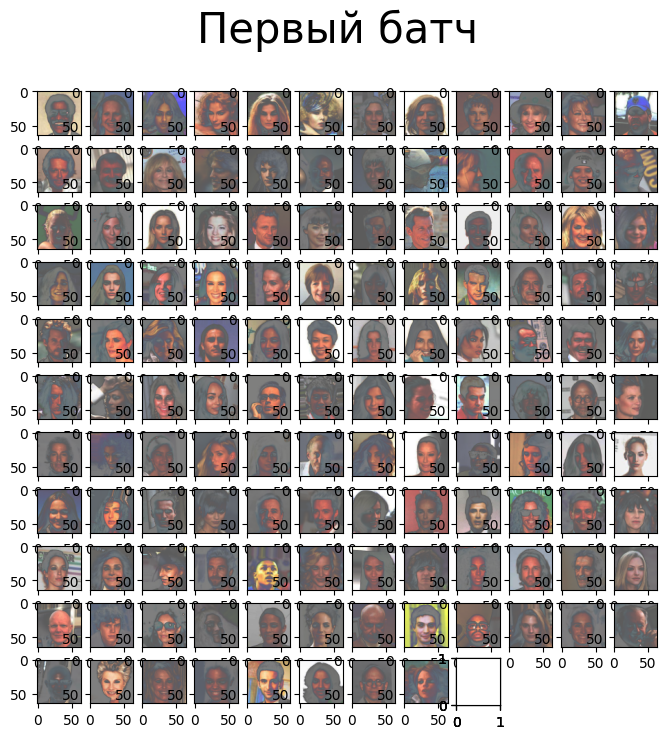

In [10]:
show_first_batch(loader)

In [11]:
# Getting device
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(f"Using device: {device}\t" + (f"{torch.cuda.get_device_name(0)}" if torch.cuda.is_available() else "CPU"))

Using device: cpu	CPU


# Denoising Diffusion Model (DDPM) (2 балла)

## Recap
Диффузия - это обратимый стохастический процесс, в котором картинка зашумляется по известному гауссовскому закону $q(x_t|x_{t-1})$ и денойзится по неизвестному обратному гауссовскому закону $p(x_{t-1}|x_t)$, который приближается нейросетью $p_\theta$
![](https://lilianweng.github.io/posts/2021-07-11-diffusion-models/DDPM.png)

Известный закон $q$ (он же forward pass) описывается по формуле:
$$
\begin{aligned}
\mathbf{x}_t 
&= \sqrt{\alpha_t}\mathbf{x}_{t-1} + \sqrt{1 - \alpha_t}\boldsymbol{\epsilon}_{t-1} & \text{ ;where } \boldsymbol{\epsilon}_{t-1}, \boldsymbol{\epsilon}_{t-2}, \dots \sim \mathcal{N}(\mathbf{0}, \mathbf{I}) \\
&= \sqrt{\alpha_t \alpha_{t-1}} \mathbf{x}_{t-2} + \sqrt{1 - \alpha_t \alpha_{t-1}} \bar{\boldsymbol{\epsilon}}_{t-2} & \text{ ;where } \bar{\boldsymbol{\epsilon}}_{t-2} \text{ merges two Gaussians (*).} \\
&= \dots \\
&= \sqrt{\bar{\alpha}_t}\mathbf{x}_0 + \sqrt{1 - \bar{\alpha}_t}\boldsymbol{\epsilon} \\
q(\mathbf{x}_t \vert \mathbf{x}_0) &= \mathcal{N}(\mathbf{x}_t; \sqrt{\bar{\alpha}_t} \mathbf{x}_0, (1 - \bar{\alpha}_t)\mathbf{I})
\end{aligned}
$$, где $\alpha$ - заранее определенные по определенной сетке константы

Неизвестная же гауссиана обратного закона (он же backward pass) предсказывается нейросетью:
$p_\theta(x_{t-1}|x_t) = \mathcal{N}(x_{t-1};\mu_\theta(x_t, t),\sigma_\theta(x_t,t))$ (т.е. предсказываются $\mu$ и $\sigma$, 1в1 как в вариационном енкодере)

Кроме этого, так же, как в варэнкодере, $p_\theta$ выучивается максимизацией ELBO (и даже KL там тоже между двумя гауссианами)

Ну а выучив обратный процесс денойзинга $p_\theta(x_{t-1}|x_t)$, дело останется за малым: берём $x_T\sim\mathcal{N}(0,1)$ и семплируем $x_{t-1}\sim p_\theta(x_{t-1}|x_t)$, пока не восстановим наш незашумленный $x_0$. Это и будет какая-то картинка

## DDPM

С варвыводом вы уже хорошо знакомы, но авторы DDPM решили с ним не париться и забить на $\sigma_t$, сделав её заранее определённой константой, например:
- $\sigma_t^2$ = $\beta_t$
- $\sigma_t^2$ = $\frac{1 - \bar{\alpha_{t-1}}}{1 - \bar{\alpha_{t}}} \beta_t$

Тогда
$$q(x_{t-1}|x_0, x_t)=\mathcal{N}(x_{t-1}|\mu_t^q,\sigma_t)$$
$$p_\theta(x_{t-1}|x_t)=\mathcal{N}(x_{t-1}|\mu_t^\theta,\sigma_t)$$

Кроме этого, из вышеуказанного прямого закона $q$ несложно представить $\mu_t^q$ в виде 

$$\boldsymbol{\mu}^q_t = \frac{1}{\sqrt{\alpha_t}} \Big( \mathbf{x}_t - \frac{1 - \alpha_t}{\sqrt{1 - \bar{\alpha}_t}} \boldsymbol{\epsilon}_t \Big)$$

Так давайте представим и $\mu^\theta_t$ в таком виде, раз так:
$$\boldsymbol{\mu}^\theta_t = \frac{1}{\sqrt{\alpha_t}} \Big( \mathbf{x}_t - \frac{1 - \alpha_t}{\sqrt{1 - \bar{\alpha}_t}} \boldsymbol{\epsilon}_t^\theta(x_t,t) \Big)$$ 

Тогда весь $KL(q|p_\theta)$ сведётся к минимизации MSE

$$||\mu_t^q-\mu_t^\theta||^2\sim||\epsilon_t-\epsilon_t^\theta(x_t,t)||^2$$

Ну а зашумленный $x_t$ можно считать из исходного $x_0$ по быстрой формуле (см. самое начало):

$$x_t=\sqrt{\bar{\alpha}_t}\mathbf{x}_0 + \sqrt{1 - \bar{\alpha}_t}\boldsymbol{\epsilon}_t$$

$\epsilon_t$ же на деле берут случайно из $\mathcal{N}(0,1)$

Итого, все-эти-ваши диффузии можно представить в виде нескольких строк кода:
![](https://lilianweng.github.io/posts/2021-07-11-diffusion-models/DDPM-algo.png)

Прим. В качестве $\epsilon^\theta$ берут любой Unet-like бэкбон (кроме этого, есть оптимизированный под диффузию Efficient Unet)

Для большей инфы по диффузии идите сюда https://lilianweng.github.io/posts/2021-07-11-diffusion-models/


In [12]:
class DDPM(nn.Module):
    def __init__(self, network, # Unet
                 n_steps=1000, # число шагов диффузии
                 min_beta=1e-4, # минимальное значение beta
                 max_beta=0.02, # максимальное значение beta
                 device=None,
                 image_chw=(3, image_size, image_size)):
        super().__init__()
        self.n_steps = n_steps
        self.device = device
        self.image_chw = image_chw
        self.network = network.to(device)
        
        # сетка beta, линейная от min_beta до max_beta
        self.betas = torch.linspace(min_beta, max_beta, n_steps).to(device)
        self.alphas = 1.0 - self.betas
        self.alpha_bars = torch.cumprod(self.alphas, dim=0)

    def forward(self, x0, t, eta=None):
        if eta is None:
            eta = torch.randn_like(x0).to(self.device)

        sqrt_alpha_bars = torch.sqrt(self.alpha_bars[t]).reshape(-1, 1, 1, 1)
        sqrt_one_minus_alpha_bars = torch.sqrt(1 - self.alpha_bars[t]).reshape(-1, 1, 1, 1)
        noised_x = sqrt_alpha_bars * x0 + sqrt_one_minus_alpha_bars * eta

        return noised_x

    def backward(self, x, t):
        eta_pred = self.network(x, t)
        return eta_pred

## Visualizing forward and backward (2 балла)

In [13]:
def show_forward(ddpm, loader, device):
    for batch in loader:
        imgs = batch[0].to(device)

        show_images(imgs, "Original images")

        for percent in [0.25, 0.5, 0.75, 1]:  # Шаг зашумления (в процентах от максимального)
            t = torch.tensor([int(percent * (ddpm.n_steps - 1))] * imgs.size(0)).to(device)
            noised_images = ddpm(imgs, t)  # прямой проход DDPM
            show_images(
                noised_images,
                f"DDPM Noisy images {int(percent * 100)}%"
            )
        break

In [14]:
def generate_new_images(ddpm, n_samples=16, device=None, frames_per_gif=100,
                        gif_name="sampling.gif", c=3, h=image_size, w=image_size):
    frame_idxs = np.linspace(0, ddpm.n_steps, frames_per_gif).astype(np.uint)
    frames = []

    with torch.no_grad():
        if device is None:
            device = ddpm.device

        # Starting from random noise
        x = torch.randn(n_samples, c, h, w).to(device)  # Начинаем генерить картинки с гауссовского шума N(0,1)

        for idx, t in enumerate(list(range(ddpm.n_steps))[::-1]):  # Денойзим наши картинки для каждого шага, начиная с последнего
            # Estimating noise to be removed
            time_tensor = torch.tensor([t] * n_samples).long().to(device).unsqueeze(1)  # [n_samples, 1].long()
            eta_theta = ddpm.backward(x, time_tensor)  # Предсказываем добавочный шум нейросетью

            alpha_t = ddpm.alphas[t]
            alpha_t_bar = ddpm.alpha_bars[t]

            # Partially denoising the image
            x = (x - (1 - alpha_t) / torch.sqrt(1 - alpha_t_bar) * eta_theta) / torch.sqrt(alpha_t)

            if t > 0:
                z = torch.randn(n_samples, c, h, w).to(device)

                sigma_t = torch.sqrt(ddpm.betas[t])  # определите сигму по стандартному DDPM способу

                x = x + sigma_t * z

            # Adding frames to the GIF
            if idx in frame_idxs or t == 0:
                normalized = x.clone()
                normalized = (normalized - normalized.min()) / (normalized.max() - normalized.min()) * 255

                # Reshaping batch (n, c, h, w) to be a (as much as it gets) square frame
                frame = einops.rearrange(normalized, "(b1 b2) c h w -> (b1 h) (b2 w) c", b1=int(n_samples ** 0.5))
                frame = frame.cpu().numpy().astype(np.uint8)

                # Rendering frame
                frames.append(frame)

    # Storing the gif
    with imageio.get_writer(gif_name, mode="I") as writer:
        for idx, frame in enumerate(frames):
            writer.append_data(frame)
            if idx == len(frames) - 1:
                for _ in range(frames_per_gif // 3):
                    writer.append_data(frames[-1])
    return x

# UNet backbone ($\epsilon^\theta$) (3 балла)

Как уже было сказано, в качестве $\epsilon^\theta$ подойдёт любой Unet-like бэкбон (который будет принимать на вход зашумлённую картинку и на выходе возвращать восстановленный шум $\epsilon_t$ той же размерности). Одна незадача - вторым аргументом $\epsilon^\theta$ принимает время (шаг зашумления) $t$, чего в ванильном Unet'e нет.

К счастью, есть миллион и один способ добавить время дополнительным аргументом (например, AdaIN, как в StyleGAN, дополнительным каналом и т.д.)

На практике же в DDPM делают positional encoding (тот самый, который в Трансформере) времени $t$ и дальше просто плюсуют его прямо к входной картинке $x$. Мало того, вместе в временем иногда ещё и какие-нибудь текстовые эмбединги приплюсовывают (сжимая их нехитрым образом до нужной размерности через дополнительный линейный слой)

С текстовыми эмбедингами мы работать в этой домашке не будем, а вот $t$ добавлять будем ровно последним способом 

In [15]:
def sinusoidal_embedding(n, d):
    # n - размерность исходных данных (в нашем случае число моментов времени)
    # d - выходная размерность
    embedding = torch.zeros(n, d)
    wk = torch.tensor([1 / 10_000 ** (2 * j / d) for j in range(d // 2)])  # коэффициенты для d/2 гармоник
    wk = wk.reshape((1, d // 2))
    t = torch.arange(n).reshape((n, 1))
    embedding[:, ::2] = torch.sin(t * wk)
    embedding[:, 1::2] = torch.cos(t * wk)
    return embedding

class UNet(nn.Module):
    def __init__(self, n_steps=1000, time_emb_dim=100):
        super().__init__()

        # Sinusoidal embedding
        self.time_embed = nn.Embedding(n_steps, time_emb_dim)
        self.time_embed.weight.data = sinusoidal_embedding(n_steps, time_emb_dim)
        self.time_embed.requires_grad_(False)  # мы эмбединг слой уже инициализировали и менять его не будем

        # First half
        self.te1 = self._make_te(time_emb_dim, 1)

        # UNet Blocks (простой вариант для демонстрации)
        self.conv1 = nn.Conv2d(3, 64, 3, padding=1)
        self.conv2 = nn.Conv2d(64, 128, 3, padding=1)
        self.conv3 = nn.Conv2d(128, 64, 3, padding=1)
        self.conv4 = nn.Conv2d(64, 3, 3, padding=1)
        self.relu = nn.ReLU()

    def _make_te(self, dim_in, dim_out):
        return nn.Sequential(
            nn.Linear(dim_in, dim_out),
            nn.SiLU(),
            nn.Linear(dim_out, dim_out)
        )

    def forward(self, x, t):
        t = self.time_embed(t)
        n = len(x)
        x = x + self.te1(t).reshape(n, -1, 1, 1)

        x = self.relu(self.conv1(x))
        x = self.relu(self.conv2(x))
        x = self.relu(self.conv3(x))
        out = self.conv4(x)  # (N, 3, 32, 32)

        return out

In [16]:
# Defining model
n_steps, min_beta, max_beta = 1000, 1e-4, 0.02
ddpm = DDPM(UNet(n_steps=1000), n_steps=n_steps, min_beta=min_beta, max_beta=max_beta, device=device)

In [17]:
sum([p.numel() for p in ddpm.parameters()])

251274

# Optional visualizations

In [18]:
# Optionally, load a pre-trained model that will be further trained
# ddpm.load_state_dict(torch.load(store_path, map_location=device))

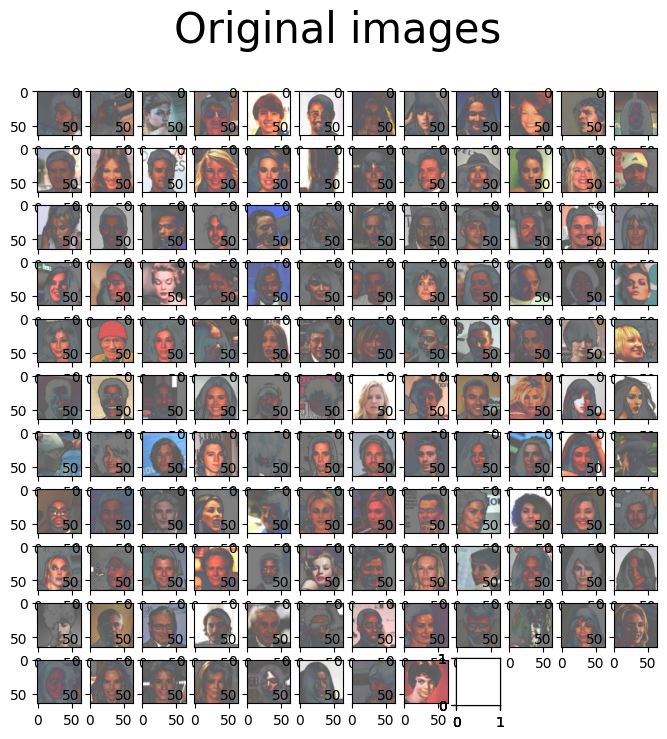

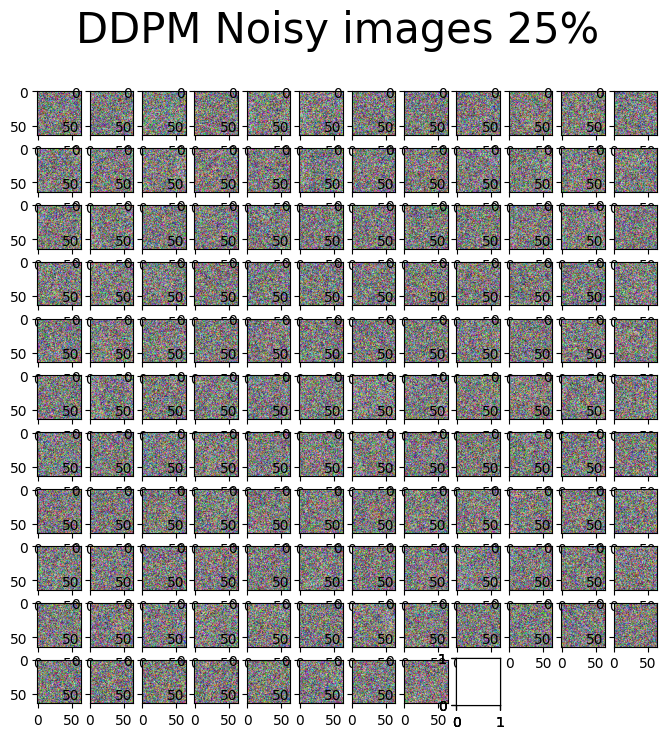

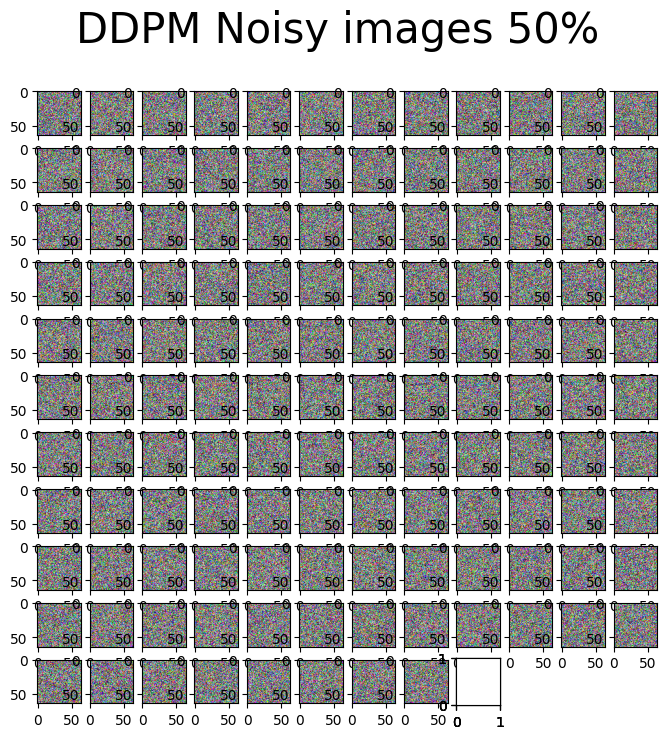

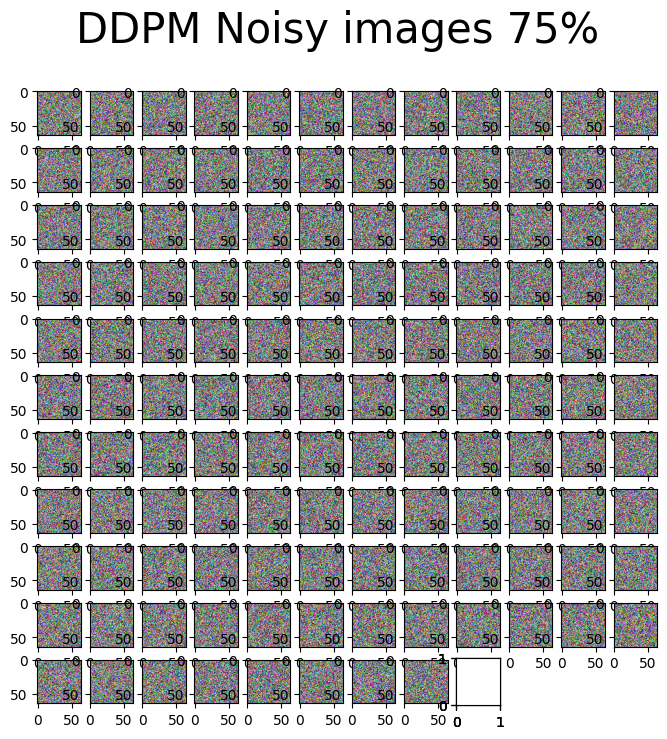

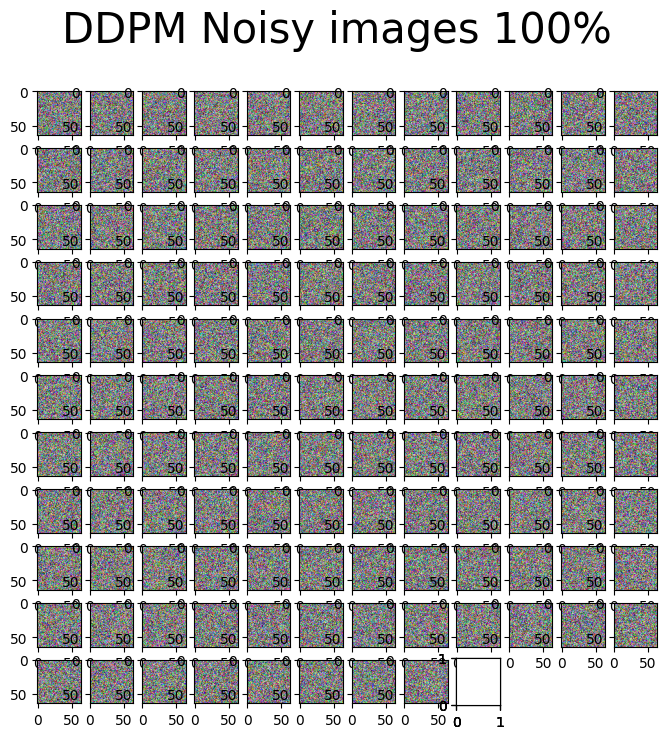

In [19]:
# Optionally, show the diffusion (forward) process
show_forward(ddpm, loader, device)

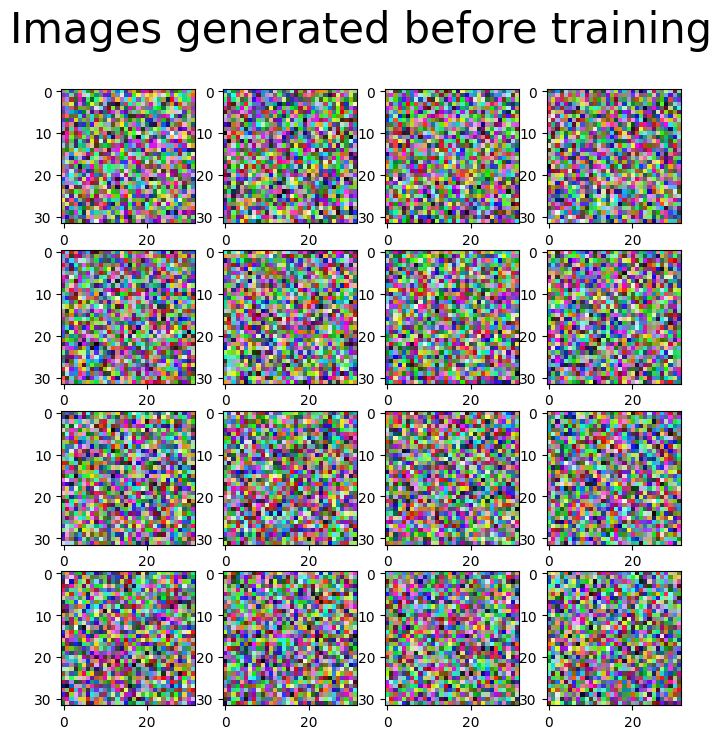

In [20]:
# Optionally, show the denoising (backward) process
generated = generate_new_images(ddpm, gif_name="before_training.gif")
show_images(generated, "Images generated before training")

# Обучение (1 балл)
![](https://lilianweng.github.io/posts/2021-07-11-diffusion-models/DDPM-algo.png)

In [21]:
def training_loop(ddpm, loader, n_epochs, optim, device, display=False, store_path="ddpm_model.pt"):
    mse = nn.MSELoss()
    best_loss = float("inf")
    n_steps = ddpm.n_steps

    for epoch in tqdm(range(n_epochs), desc=f"Training progress", colour="#00ff00"):
        epoch_loss = 0.0
        for step, batch in enumerate(tqdm(loader, leave=False, desc=f"Epoch {epoch + 1}/{n_epochs}", colour="#005500")):
            x0 = batch[0].to(device)
            
            eta = torch.randn_like(x0).to(device)  # инициализируем добавочный шум
            t = torch.randint(0, n_steps, (x0.size(0), 1)).long().to(device)

            noisy_imgs = ddpm(x0, t, eta)  # получаем зашумленное изображение для шага t 

            # Getting model estimation of noise based on the images and the time-step
            eta_theta = ddpm.backward(noisy_imgs, t)  # восстанавливаем добавочный шум

            loss = mse(eta_theta, eta)  # учимся его восстанавливать нейросетью
            optim.zero_grad()
            loss.backward()
            optim.step()

            epoch_loss += loss.item() * len(x0) / len(loader.dataset)

        # Display images generated at this epoch
        if display:
            show_images(generate_new_images(ddpm, device=device), f"Images generated at epoch {epoch + 1}")

        log_string = f"Loss at epoch {epoch + 1}: {epoch_loss:.3f}"

        # Storing the model
        if best_loss > epoch_loss:
            best_loss = epoch_loss
            torch.save(ddpm.state_dict(), store_path)
            log_string += " --> Best model ever (stored)"

        print(log_string)

In [22]:
# Training
n_epochs = 20
lr = 1e-4
store_path = "models/ddpm_model.pt"

if not os.path.isdir(os.path.dirname(store_path)):
    os.makedirs(os.path.dirname(store_path), exist_ok=True)

training_loop(
    ddpm,
    loader,
    n_epochs=n_epochs,
    optim=Adam(ddpm.parameters(), lr=lr),
    device=device,
    store_path=store_path
)

Training progress:   5%|▌         | 1/20 [01:01<19:32, 61.72s/it]

Loss at epoch 1: 0.937 --> Best model ever (stored)


Training progress:  10%|█         | 2/20 [02:03<18:27, 61.53s/it]

Loss at epoch 2: 0.658 --> Best model ever (stored)


Training progress:  15%|█▌        | 3/20 [03:04<17:22, 61.34s/it]

Loss at epoch 3: 0.307 --> Best model ever (stored)


Training progress:  20%|██        | 4/20 [04:05<16:20, 61.26s/it]

Loss at epoch 4: 0.163 --> Best model ever (stored)


Training progress:  25%|██▌       | 5/20 [05:06<15:17, 61.20s/it]

Loss at epoch 5: 0.140 --> Best model ever (stored)


Training progress:  30%|███       | 6/20 [06:07<14:16, 61.15s/it]

Loss at epoch 6: 0.128 --> Best model ever (stored)


Training progress:  35%|███▌      | 7/20 [07:09<13:18, 61.43s/it]

Loss at epoch 7: 0.121 --> Best model ever (stored)


Training progress:  40%|████      | 8/20 [08:10<12:16, 61.35s/it]

Loss at epoch 8: 0.126


Training progress:  45%|████▌     | 9/20 [09:11<11:14, 61.28s/it]

Loss at epoch 9: 0.115 --> Best model ever (stored)


Training progress:  50%|█████     | 10/20 [10:13<10:13, 61.36s/it]

Loss at epoch 10: 0.115


Training progress:  55%|█████▌    | 11/20 [11:14<09:11, 61.28s/it]

Loss at epoch 11: 0.113 --> Best model ever (stored)


Training progress:  60%|██████    | 12/20 [12:15<08:09, 61.21s/it]

Loss at epoch 12: 0.111 --> Best model ever (stored)


Training progress:  65%|██████▌   | 13/20 [13:16<07:08, 61.15s/it]

Loss at epoch 13: 0.108 --> Best model ever (stored)


Training progress:  70%|███████   | 14/20 [14:17<06:06, 61.14s/it]

Loss at epoch 14: 0.104 --> Best model ever (stored)


Training progress:  75%|███████▌  | 15/20 [15:18<05:05, 61.16s/it]

Loss at epoch 15: 0.102 --> Best model ever (stored)


Training progress:  80%|████████  | 16/20 [16:20<04:05, 61.43s/it]

Loss at epoch 16: 0.100 --> Best model ever (stored)


Training progress:  85%|████████▌ | 17/20 [17:22<03:04, 61.52s/it]

Loss at epoch 17: 0.098 --> Best model ever (stored)


Training progress:  90%|█████████ | 18/20 [18:24<02:03, 61.61s/it]

Loss at epoch 18: 0.095 --> Best model ever (stored)


Training progress:  95%|█████████▌| 19/20 [19:26<01:01, 61.59s/it]

Loss at epoch 19: 0.089 --> Best model ever (stored)


Training progress: 100%|██████████| 20/20 [20:27<00:00, 61.35s/it]

Loss at epoch 20: 0.082 --> Best model ever (stored)


# Генерёжка (2 балла за хорошие картинки)

In [ ]:
# Loading the trained model
# Загружаем state_dict
checkpoint = torch.load("models/ddpm_model.pt", map_location=device)

# Загружаем веса в модель
ddpm.load_state_dict(checkpoint)
ddpm.eval()
print("Model loaded")

Model loaded


Generating new images


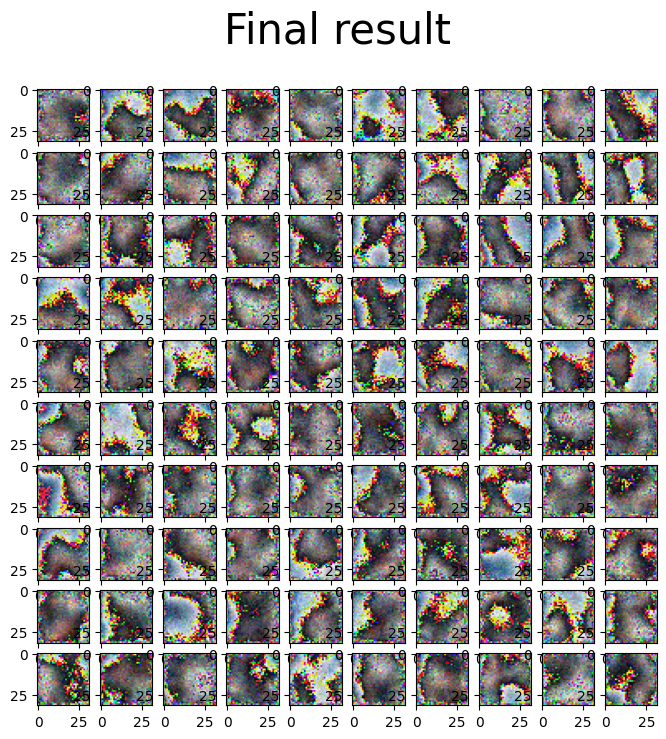

In [25]:
print("Generating new images")
generated = generate_new_images(
        ddpm,
        n_samples=100,
        device=device,
        gif_name="celeba.gif"
    )
show_images(generated, "Final result")

# Visualizing the diffusion

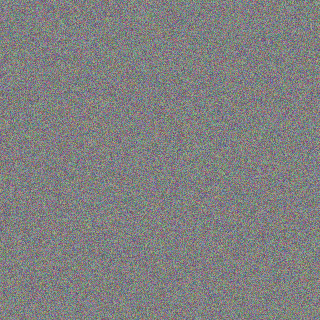

In [27]:
from IPython.display import Image

Image(open('celeba.gif','rb').read())